In [49]:
import pandas as pd
import pyarrow.parquet as pq
import os
import numpy as np
import matplotlib.pyplot as plt
import random
from scipy.fftpack import fft, ifft
import scipy.integrate as integrate

from tqdm import trange
import gc
import seaborn as sns
from tqdm import tqdm

from sklearn.feature_extraction.text import CountVectorizer
import re
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn import metrics
from scipy import fftpack

from bokeh.plotting import figure,show,output_file, ColumnDataSource
from bokeh.io import push_notebook, output_notebook
from bokeh.layouts import column

from sklearn.model_selection import KFold
import lightgbm as lgb

output_notebook()

Loading BokehJS ...

In [33]:
%%time
meta_train = pd.read_csv('input/metadata_train.csv')
subset_train = pq.read_pandas('input/train.parquet').to_pandas()

CPU times: user 1min 45s, sys: 46.7 s, total: 2min 32s
Wall time: 40.9 s


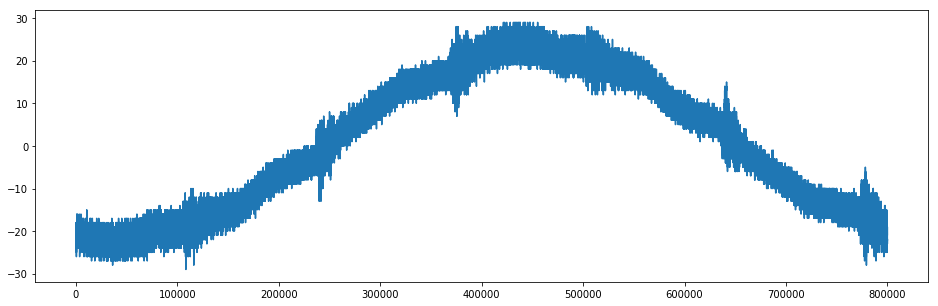

In [35]:
plt.figure(figsize = (16,5))
plt.plot(subset_train['349'])
plt.show()

In [63]:
fft1 = np.fft.ifft(subset_train['349'])
fft2 = fftpack.fft(subset_train['349'])
len(fft1)

800000

In [79]:
np.array(subset_train['349'].tolist()).shape

(800000,)

In [103]:
N_points=subset_train.shape[0]
millisecs=20

x=np.linspace(0,millisecs,N_points)
myfunc = np.array(subset_train['349'].tolist())

FFT = fftpack.fft(myfunc)

p=figure(plot_width=900, plot_height=250,x_range=(0, millisecs))
p.line(x=x,y=myfunc,alpha=0.5)

r=figure(plot_width=900, plot_height=250,x_range=(5,N_points/millisecs/2))
r.line(x=1./millisecs* np.arange(len(FFT)),y=np.abs(FFT),color='red')

show(column(p,r))

In [90]:
%%time
train_length = meta_train.shape[0]
positive_length = len(meta_train[meta_train.target == 1])

train_df = pd.DataFrame()
row_index = 0
for i in range(train_length):
    # downsampling
    if meta_train.loc[i,'target'] == 1 or random.random() < positive_length / train_length:
        subset_train_row = subset_train[str(i)]
        train_df.loc[row_index, 'signal_min'] = subset_train_row.min()
        train_df.loc[row_index, 'signal_max'] = subset_train_row.max()
        train_df.loc[row_index, 'signal_mean'] = subset_train_row.mean()
        train_df.loc[row_index, 'signal_std'] = subset_train_row.std()
        
        ffT = np.fft.ifft(subset_train_row, n = 30000)[5:30000].real
        
        train_df.loc[row_index, 'FTs_max'] = ffT.max()
        train_df.loc[row_index, 'FTs_integral'] = abs(ffT).sum()
        train_df.loc[row_index, 'FTs_std'] = ffT.std()
        
        # *** Add your feature here ***
        train_df.loc[row_index, 'signal_id'] = i
        row_index += 1
print("positive length: " + str(positive_length))
# positive length 525
print("train length: " + str(len(train_df)))
# train length 1038  example
# This will be about 1050

train_df = pd.merge(train_df, meta_train, on='signal_id')
train_df.to_csv("train.csv", index=False)
train_df.head()

positive length: 525
train length: 8712
CPU times: user 5min 29s, sys: 29.4 s, total: 5min 58s
Wall time: 19min 59s


In [116]:
(525/8712)*100

6.026170798898072

In [104]:
x_train = train_df.copy()
target = x_train['target']
input_target = x_train['target']
x_train.drop(['target', 'signal_id'], axis=1, inplace=True)
features = x_train.columns
param = {'num_leaves': 90,
         'min_data_in_leaf': 80, 
         'objective':'binary',
         'max_depth': -1,
         'learning_rate': 0.05,
         "boosting": "gbdt",
         "feature_fraction": 0.8,
         "bagging_freq": 2,
         "bagging_fraction": 0.8 ,
         "bagging_seed": 11,
         "metric": 'auc',
         "lambda_l1": 0.1,
         "random_state": 164,
         "verbosity": -1}
max_iter=5


In [105]:
folds = KFold(n_splits=6, shuffle=True, random_state=19)
oof = np.zeros(len(x_train))
feature_importance_df = pd.DataFrame()
score = [0 for _ in range(folds.n_splits)]
for fold_, (trn_idx, val_idx) in enumerate(folds.split(x_train.values, target.values)):
    print("Fold No.{}".format(fold_+1))
    trn_data = lgb.Dataset(x_train.iloc[trn_idx][features],
                           label=target.iloc[trn_idx])
    val_data = lgb.Dataset(x_train.iloc[val_idx][features],
                           label=target.iloc[val_idx])
    num_round = 15000
    clf = lgb.train(param,
                    trn_data,
                    num_round,
                    valid_sets = [trn_data, val_data],
                    verbose_eval=100,
                    early_stopping_rounds = 300)
    
    oof[val_idx] = clf.predict(x_train.iloc[val_idx][features], num_iteration=clf.best_iteration)
    fold_importance_df = pd.DataFrame()
    fold_importance_df["feature"] = features
    fold_importance_df["importance"] = clf.feature_importance(importance_type='gain')
    fold_importance_df["fold"] = fold_ + 1
    feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
    score[fold_] = metrics.roc_auc_score(target.iloc[val_idx], oof[val_idx])
    if fold_ == max_iter - 1: break
        
if (folds.n_splits == max_iter):
    print("CV score: {:<8.5f}".format(metrics.roc_auc_score(target, oof)))
else:
     print("CV score: {:<8.5f}".format(sum(score) / max_iter))

Fold No.1
Training until validation scores don't improve for 300 rounds.
[100]	training's auc: 0.994026	valid_1's auc: 0.944149
[200]	training's auc: 0.999897	valid_1's auc: 0.950348
[300]	training's auc: 1	valid_1's auc: 0.952971
[400]	training's auc: 1	valid_1's auc: 0.953911
[500]	training's auc: 1	valid_1's auc: 0.95378
Early stopping, best iteration is:
[268]	training's auc: 1	valid_1's auc: 0.952162
Fold No.2
Training until validation scores don't improve for 300 rounds.
[100]	training's auc: 0.994266	valid_1's auc: 0.921328
[200]	training's auc: 0.999933	valid_1's auc: 0.930908
[300]	training's auc: 1	valid_1's auc: 0.92924
[400]	training's auc: 1	valid_1's auc: 0.930443
Early stopping, best iteration is:
[190]	training's auc: 0.999884	valid_1's auc: 0.931629
Fold No.3
Training until validation scores don't improve for 300 rounds.
[100]	training's auc: 0.994792	valid_1's auc: 0.910104
[200]	training's auc: 0.999907	valid_1's auc: 0.916914
[300]	training's auc: 1	valid_1's auc: 0

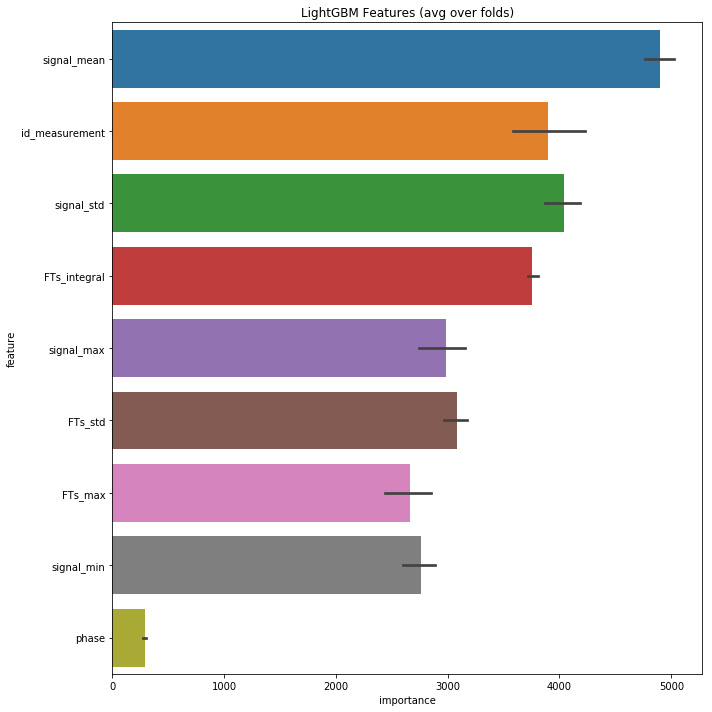

In [106]:
cols = (feature_importance_df[["feature", "importance"]]
        .groupby("feature")
        .mean()
        .sort_values(by="importance", ascending=False)[:1000].index)
best_features = feature_importance_df.loc[feature_importance_df.feature.isin(cols)]

plt.figure(figsize=(10,10))
sns.barplot(x="importance",
            y="feature",
            data=best_features.sort_values(by="importance",ascending=False))
plt.title('LightGBM Features (avg over folds)')
plt.tight_layout()

In [107]:
gc.collect()

3182

# Predict and Submit

In [108]:
%%time
# 25ms in Kernel
meta_test = pd.read_csv('input/metadata_test.csv')

CPU times: user 8.3 ms, sys: 3.89 ms, total: 12.2 ms
Wall time: 11 ms


In [109]:
%%time
meta_test = pd.read_csv('input/metadata_test.csv')
subset_test = pq.read_pandas('input/test.parquet').to_pandas()

CPU times: user 4min 23s, sys: 2min 3s, total: 6min 26s
Wall time: 2min 19s


In [110]:
test_length = meta_test.shape[0]

test_df = pd.DataFrame()
row_index = 0
for i in trange(test_length):
#     import pdb; pdb.set_trace()
    subset_test_row = subset_test[str(i+8712)]
    test_df.loc[row_index, 'signal_min'] = subset_test_row.min()
    test_df.loc[row_index, 'signal_max'] = subset_test_row.max()
    test_df.loc[row_index, 'signal_mean'] = subset_test_row.mean()
    test_df.loc[row_index, 'signal_std'] = subset_test_row.std()

    ffT = np.fft.ifft(subset_test_row, n = 30000)[5:30000].real

    test_df.loc[row_index, 'FTs_max'] = ffT.max()
    test_df.loc[row_index, 'FTs_integral'] = abs(ffT).sum()
    test_df.loc[row_index, 'FTs_std'] = ffT.std()

    # *** Add your feature here ***
    test_df.loc[row_index, 'signal_id'] = i + 8712
    row_index += 1
print("test length: " + str(len(test_df)))

100%|██████████| 20337/20337 [14:08<00:00, 23.97it/s]

test length: 20337


In [111]:
test_length, test_df.shape

(20337, (20337, 8))

In [112]:
test_df = pd.merge(test_df, meta_test, on='signal_id')
test_df.to_csv("test.csv", index=False)

test_df.head()

,signal_min,signal_max,signal_mean,signal_std,FTs_max,FTs_integral,FTs_std,signal_id,id_measurement,phase
0,-46.0,28.0,-1.007639,13.805535,0.142591,50.038615,0.003732,8712.0,2904,0
1,-25.0,30.0,-0.178762,13.972893,0.150429,48.296124,0.003450,8713.0,2904,1
2,-27.0,31.0,-0.031567,13.806489,0.212504,50.801163,0.003768,8714.0,2904,2
3,-29.0,28.0,-0.021024,14.098745,0.225039,51.718029,0.006919,8715.0,2905,0
4,-35.0,29.0,-1.479971,13.573268,0.181641,52.244214,0.005958,8716.0,2905,1


In [113]:
x_test = test_df
x_filename = x_test['signal_id']
x_test = x_test.drop('signal_id', axis=1)

predictions = clf.predict(x_test, num_iteration=clf.best_iteration)

sub_df = pd.DataFrame({"signal_id":x_filename.values})
sub_df["target"] = pd.Series(predictions).round()
sub_df['signal_id'] = sub_df['signal_id'].astype(np.int64)
sub_df['target'] = sub_df['target'].astype(np.int64)
sub_df.to_csv("submission_three.csv", index=False)
sub_df

,signal_id,target
0,8712,0
1,8713,0
2,8714,0
3,8715,0
4,8716,0
5,8717,0
6,8718,0
7,8719,0
8,8720,0
9,8721,0


In [114]:
positive = len(sub_df[sub_df["target"] == 1])
print(positive)
print(str(positive/len(sub_df)*100) + "%")

129
0.6343118454049269%


# Demonstrations

In [9]:
def show_shit(num_ = None):
    if not num_:
        num_ = np.random.randint(0,dataset.shape[0])
    print('Plot number: {}. Condition: {}'.format(num_, meta_.target.iloc[num_]))
    plt.figure(figsize=(15, 6))
    slic = dataset[num_]
    plt.plot(slic, label='Phase 0')
    print('Max: {}, min: {}, std deviation: {}, agv: {}'.format(slic.max(), slic.min(), slic.std(), slic.mean()))
    plt.legend()
    plt.show()

Plot number: 54. Condition: 0
Max: 34, min: -36, std deviation: 14.39839243907713, agv: -1.00969125


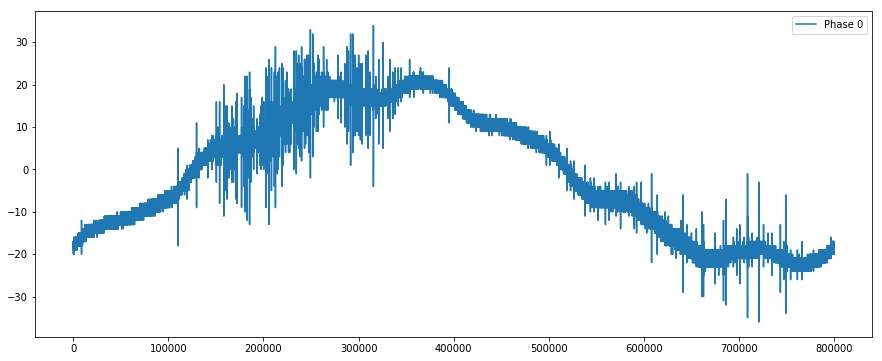

In [14]:
show_shit()